In [1]:
import pandas as pd
import geopandas as gpd
import geofeather
import matplotlib.pyplot as plt

In [14]:
acs_tracts_geo = geofeather.from_geofeather('../data/clean/acs_tracts_geo.feather')

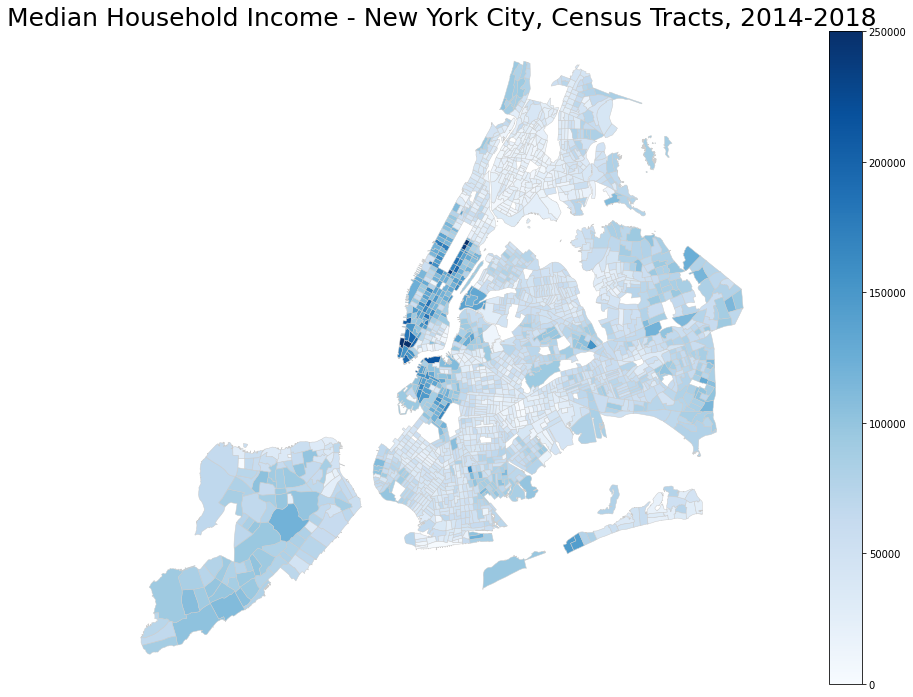

In [3]:
# set a variable that will call whatever column we want to visualise on the map
variable = 'hh_inc_medE'
# set the range for the choropleth
vmin, vmax = 0, acs_tracts_geo[variable].max()
# create figure and axes for Matplotlib
fig, ax = plt.subplots(1, figsize=(20, 12))

acs_tracts_geo.plot(column=variable, cmap='Blues', linewidth=0.5, ax=ax, edgecolor='0.8')

ax.axis('off')

# add a title
ax.set_title(
    'Median Household Income - New York City, Census Tracts, 2014-2018', 
    fontdict={'fontsize': '25', 'fontweight' : '3'}
)

# Create colorbar as a legend
sm = plt.cm.ScalarMappable(cmap='Blues', norm=plt.Normalize(vmin=vmin, vmax=vmax))
# empty array for the data range
sm._A = []
# add the colorbar to the figure
cbar = fig.colorbar(sm)


In [17]:
fig.savefig('../img/nyc_hh_inc_map.png')

## Interactive  visualizations with Plotly
Plotly is a popular javascript framework for interactive data visualization, and they have a [Python](https://plotly.com/python/) and [R](https://plotly.com/r/) library that makes it easy to take advantage of all the great interactive features without haveing to learn javascript.

Furthermore, Plotly for python has a module `plotly.express` that makes it even easier to make plots/maps quickly. We'll be using that for the examples here, but you shouhld be able to cusomize things further using the standard library.

In [ ]:
import plotly.express as px

### Interactive Maps with Plotly

The plotly mapping functions all seem to want the geoemetry data in geojson format and a separate dataframe with the non-spatial data, and doesn't yet support geopandas to have this all in one. Since we already have it as a geopandas we can export to geojson and read it back in that way. 

One thing to always remember is that geojson needs to have the geometries in CRS=4326 (lat/lon) so we reproject the data before exporting.

In [15]:
acs_tracts_geo.to_crs(4326).to_file('../data/clean/acs_tracts_geo.geojson', driver='GeoJSON')

In [16]:
import json

with open('../data/clean/acs_tracts_geo.geojson') as f:
  acs_tracts_geo_json = json.load(f)

In [37]:
fig = px.choropleth_mapbox(
    acs_tracts_geo, # our dataframe with non-spatial data values to visualize
    geojson=acs_tracts_geo_json, # geojson file with geometries
    
    # these next two are the non-spatial column to use as the join key between the geometries and the data
    locations="geoid", # the name of the column in the non-spatial DF that identifies each geometry
    featureidkey="properties.geoid", # the name of the same ID as above, but in the geojson colum
    
    color="hh_inc_medE", # the name of the column from the non-spatial dataframe to map
    
    # Positioning of the map. You can use http://bboxfinder.com/ to help find a good center and zoom
    center={"lat": 40.713836, "lon": -73.962513},
    mapbox_style="carto-positron", 
    zoom=9
)

fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig.show()

### Interactive Graphs with Plotly

In [40]:
fig = px.scatter(acs_tracts_geo, x="rent_burden_medE", y="hh_inc_medE", color="BoroName")
fig.show()

In [45]:
fig = px.scatter(acs_tracts_geo, x="rent_burden_medE", y="hh_inc_medE", facet_col="BoroName", facet_col_wrap=2)
fig.show()